<a href="https://colab.research.google.com/github/DhirajBembade/Twitter-Sentiment-Analysis/blob/main/Twitter_Sentiment_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# What is Sentiment Analysis?
Sentiment analysis (also known as opinion mining) is one of the many applications of Natural Language Processing. It is a set of methods and techniques used for extracting subjective information from text or speech, such as opinions or attitudes. In simple terms, it involves classifying a piece of text as positive, negative or neutral.


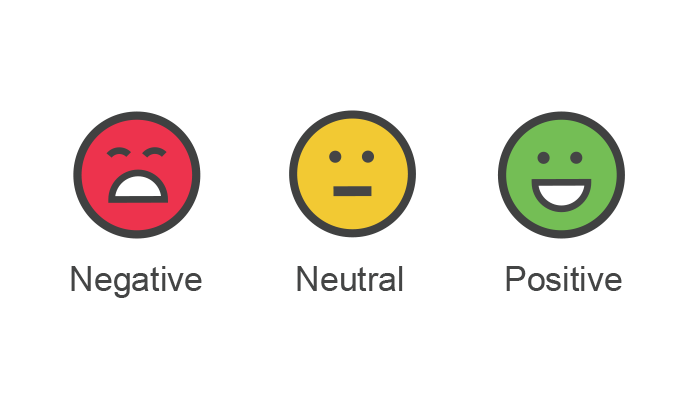

# Table of Contents

1. Problem Statement
2. Tweets Preprocessing and Cleaning
    * Data Inspection
    * Data Cleaning
3. Data Visualization from Tweets
4. Extracting Features from Cleaned Tweets
    * Bag-of-Words
    * TF-IDF
    * Word Embeddings
5. Model Building: Sentiment Analysis
    * Logistic Regression
    * Support Vector Machine
    * RandomForest
    * XGBoost
6. Model Fine-tuning
7. Summary


# 1] **The Problem Statement:**

The objective of this task is to detect hate speech in tweets. For the sake of simplicity, we say a tweet contains hate speech if it has a racist or sexist sentiment associated with it.

So, the task is to classify racist or sexist tweets from other tweets.

Formally, given a training sample of tweets and labels, where
*  **label ‘1’** denotes the tweet is **racist/sexist** and

* **label ‘0’** denotes the tweet is **not racist/sexist**,

👉 **Your objective is to predict the labels on the given test dataset.**

our task will be to classify a set of tweets into two categories:
* racist/sexist
* non-racist/sexist


## **#Loading Libraries and Data -**

In [1]:
import re      # for regular expressions
import nltk   # for text manipulation  (Natural language toolkit)
import string
import warnings

import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

#pd.set_option("display.max_colwidth", 200)
warnings.filterwarnings("ignore", category=DeprecationWarning)


In [2]:
# Let’s read train and test datasets.
data_train = pd.read_csv('/content/drive/MyDrive/train_tweets_data.csv')
data_test = pd.read_csv('/content/drive/MyDrive/test_tweets_data.csv')


# **2] Tweets Preprocessing and Cleaning :**

Text is a highly unstructured form of data, various types of noise are present in it and the data is not readily analyzable without any pre-processing. The entire process of cleaning and standardization of text, making it noise-free and ready for analysis is known as text preprocessing.

We will divide it into 2 parts:
* Data Inspection
* Data Cleaning

## **Data Inspection-**

In [3]:
data_train

,id,label,tweet
0,1,0,@user when a father is dysfunctional and is s...
1,2,0,@user @user thanks for #lyft credit i can't us...
2,3,0,bihday your majesty
3,4,0,#model i love u take with u all the time in ...
4,5,0,factsguide: society now #motivation
...,...,...,...
31957,31958,0,ate @user isz that youuu?ðððððð...
31958,31959,0,to see nina turner on the airwaves trying to...
31959,31960,0,listening to sad songs on a monday morning otw...
31960,31961,1,"@user #sikh #temple vandalised in in #calgary,..."


In [4]:
data_test

,id,tweet
0,31963,#studiolife #aislife #requires #passion #dedic...
1,31964,@user #white #supremacists want everyone to s...
2,31965,safe ways to heal your #acne!! #altwaystohe...
3,31966,is the hp and the cursed child book up for res...
4,31967,"3rd #bihday to my amazing, hilarious #nephew..."
...,...,...
17192,49155,thought factory: left-right polarisation! #tru...
17193,49156,feeling like a mermaid ð #hairflip #neverre...
17194,49157,#hillary #campaigned today in #ohio((omg)) &am...
17195,49158,"happy, at work conference: right mindset leads..."


In [5]:
# Shape of train and test data
print(data_train.shape)
print(data_test.shape)

(31962, 3)
(17197, 2)


👉 IN Train set we have 31,962 tweets and test set have 17,197 tweets.

In [6]:
data_train[data_train['label'] == 0].head(10)

,id,label,tweet
0,1,0,@user when a father is dysfunctional and is s...
1,2,0,@user @user thanks for #lyft credit i can't us...
2,3,0,bihday your majesty
3,4,0,#model i love u take with u all the time in ...
4,5,0,factsguide: society now #motivation
5,6,0,[2/2] huge fan fare and big talking before the...
6,7,0,@user camping tomorrow @user @user @user @use...
7,8,0,the next school year is the year for exams.ð...
8,9,0,we won!!! love the land!!! #allin #cavs #champ...
9,10,0,@user @user welcome here ! i'm it's so #gr...


In [7]:
data_train[data_train['label'] == 1].head(10)

,id,label,tweet
13,14,1,@user #cnn calls #michigan middle school 'buil...
14,15,1,no comment! in #australia #opkillingbay #se...
17,18,1,retweet if you agree!
23,24,1,@user @user lumpy says i am a . prove it lumpy.
34,35,1,it's unbelievable that in the 21st century we'...
56,57,1,@user lets fight against #love #peace
68,69,1,ð©the white establishment can't have blk fol...
77,78,1,"@user hey, white people: you can call people '..."
82,83,1,how the #altright uses &amp; insecurity to lu...
111,112,1,@user i'm not interested in a #linguistics tha...


In [8]:
data_train["label"].value_counts()

0    29720
1     2242
Name: label, dtype: int64

👉 In the train dataset, we have 2,242 ~7% tweets labeled as racist or sexist, and 29,720 ~93% tweets labeled as non racist/sexist. So, it is an imbalanced classification challenge.
Now we will check the distribution of length of the tweets, in terms of words, in both train and test data.

In [9]:
# Checking null Value count
data_train.isnull().sum()

id       0
label    0
tweet    0
dtype: int64

In [10]:
#Checking length of each data sample
length = data_train['tweet'].apply(lambda x:len(x))
length

0        102
1        122
2         21
3         86
4         39
        ... 
31957     68
31958    131
31959     63
31960     67
31961     32
Name: tweet, Length: 31962, dtype: int64

In [11]:
length = data_test['tweet'].apply(lambda x:len(x))
length

0         90
1        101
2         71
3        142
4         93
        ... 
17192    108
17193     96
17194    145
17195    104
17196     64
Name: tweet, Length: 17197, dtype: int64

In [12]:
length_train = data_train['tweet'].str.len()
length_test = data_test['tweet'].str.len()

fig = px.histogram(data_frame=data_train, x=length_train, nbins=20, marginal="box", color_discrete_sequence=['#1f77b4'], labels={'x': 'Tweet Length'})
fig.update_traces(marker=dict(line=dict(color='rgb(8,48,107)', width=1.5)))
fig.update_layout(title='Distribution of Tweet Length',
                  xaxis_title='Tweet Length',
                  yaxis_title='Count',
                  legend_title='Data',
                  showlegend=True)
fig.add_trace(px.histogram(data_frame=data_test, x=length_test, nbins=20, color_discrete_sequence=['#ff7f0e'], labels={'x': 'Tweet Length'}).data[0])
fig.show()


## **Data Cleaning NLP-**

In any natural language processing task, cleaning raw text data is an important step.
* It helps in getting rid of the unwanted words and characters which helps in obtaining better features.
* If we skip this step then there is a higher chance that you are working with noisy and inconsistent data.
* The objective of this step is to clean noise those are less relevant to find the sentiment of tweets such as punctuation, special characters, numbers, and terms which don’t carry much weightage in context to the text.

👇 Before we begin cleaning, let’s first combine train and test datasets. Combining the datasets will make it convenient for us to preprocess the data. Later we will split it back into train and test data.

* 👇 **Concating Two Dataframes 👇 :**

---



In [13]:
df = pd.concat([data_train, data_test] ,ignore_index=True, axis = 0)

In [14]:
df.shape

(49159, 3)

We will be following the steps below to clean the raw tweets in out data.

1. We will remove the twitter handles as they are already masked as @user due to privacy concerns. These twitter handles hardly give any information about the nature of the tweet.
2. We will also get rid of the punctuations, numbers and even special characters since they wouldn’t help in differentiating different types of tweets.
3. Most of the smaller words do not add much value. For example, ‘pdx’, ‘his’, ‘all’. So, we will try to remove them as well from our data.
4. Lastly, we will normalize the text data.  For example, reducing terms like loves, loving, and lovable to their base word, i.e., ‘love’.are often used in the same context. If we can reduce them to their root word, which is ‘love’. It will help in reducing the total number of unique words in our data without losing a significant amount of information.


**A) Removing unwanted text patterns from the Tweets:**

In [15]:
def remove_pattern(input_txt, pattern):
   r = re.findall(pattern, input_txt)
   for i in r:
    input_txt = re.sub(i, '', input_txt)
   return input_txt

**B) Removing Twitter Handles (@user)**

Creating a new column clean_tweet, it will contain the cleaned and processed tweets.

👉 Note that we have passed “@[]*” as the pattern to the remove_pattern function. It is actually a regular expression which will pick any word starting with ‘@’.

In [16]:
df['clean_tweet'] = np.vectorize(remove_pattern)(df['tweet'], "@[\w]*")
df.head(10)

,id,label,tweet,clean_tweet
0,1,0.0,@user when a father is dysfunctional and is s...,when a father is dysfunctional and is so sel...
1,2,0.0,@user @user thanks for #lyft credit i can't us...,thanks for #lyft credit i can't use cause th...
2,3,0.0,bihday your majesty,bihday your majesty
3,4,0.0,#model i love u take with u all the time in ...,#model i love u take with u all the time in ...
4,5,0.0,factsguide: society now #motivation,factsguide: society now #motivation
5,6,0.0,[2/2] huge fan fare and big talking before the...,[2/2] huge fan fare and big talking before the...
6,7,0.0,@user camping tomorrow @user @user @user @use...,camping tomorrow dannyâ¦
7,8,0.0,the next school year is the year for exams.ð...,the next school year is the year for exams.ð...
8,9,0.0,we won!!! love the land!!! #allin #cavs #champ...,we won!!! love the land!!! #allin #cavs #champ...
9,10,0.0,@user @user welcome here ! i'm it's so #gr...,welcome here ! i'm it's so #gr8 !


**C) Removing Punctuations, Numbers, and Special Characters :**

Replacing everything except characters and hashtags with spaces.

* The regular expression “[^a-zA-Z#]” means anything except alphabets and ‘#’


In [17]:
df['clean_tweet'] = df['clean_tweet'].str.replace("[^a-zA-Z#]", " ")
df.head(10)

<ipython-input-17-131e1acb7a3d>:1: FutureWarning:

The default value of regex will change from True to False in a future version.



,id,label,tweet,clean_tweet
0,1,0.0,@user when a father is dysfunctional and is s...,when a father is dysfunctional and is so sel...
1,2,0.0,@user @user thanks for #lyft credit i can't us...,thanks for #lyft credit i can t use cause th...
2,3,0.0,bihday your majesty,bihday your majesty
3,4,0.0,#model i love u take with u all the time in ...,#model i love u take with u all the time in ...
4,5,0.0,factsguide: society now #motivation,factsguide society now #motivation
5,6,0.0,[2/2] huge fan fare and big talking before the...,huge fan fare and big talking before the...
6,7,0.0,@user camping tomorrow @user @user @user @use...,camping tomorrow danny
7,8,0.0,the next school year is the year for exams.ð...,the next school year is the year for exams ...
8,9,0.0,we won!!! love the land!!! #allin #cavs #champ...,we won love the land #allin #cavs #champ...
9,10,0.0,@user @user welcome here ! i'm it's so #gr...,welcome here i m it s so #gr


**D) Removing Short Words :**

We have to be a little careful here in selecting the length of the words which we want to remove. So, I have decided to remove all the words having length 3 or less.

For example, terms like “hmm”, “oh” are of very little use. It is better to get rid of them.

In [18]:
df['clean_tweet'] = df['clean_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))
df.head(10)

,id,label,tweet,clean_tweet
0,1,0.0,@user when a father is dysfunctional and is s...,when father dysfunctional selfish drags kids i...
1,2,0.0,@user @user thanks for #lyft credit i can't us...,thanks #lyft credit cause they offer wheelchai...
2,3,0.0,bihday your majesty,bihday your majesty
3,4,0.0,#model i love u take with u all the time in ...,#model love take with time
4,5,0.0,factsguide: society now #motivation,factsguide society #motivation
5,6,0.0,[2/2] huge fan fare and big talking before the...,huge fare talking before they leave chaos disp...
6,7,0.0,@user camping tomorrow @user @user @user @use...,camping tomorrow danny
7,8,0.0,the next school year is the year for exams.ð...,next school year year exams think about that #...
8,9,0.0,we won!!! love the land!!! #allin #cavs #champ...,love land #allin #cavs #champions #cleveland #...
9,10,0.0,@user @user welcome here ! i'm it's so #gr...,welcome here


👉 As we can see the difference between the tweets column and the cleaned tweets (clean_tweet) quite clearly. Only the important words in the tweets have been retained and the noise like (numbers, punctuations, and special characters) has been removed.

**E) Text Tokenizing & Normalization :**

 Using nltk’s PorterStemmer() function to normalize the tweets. But before that we will have to tokenize the tweets.

**Tokenization**-
 *  It is the process of splitting a text object into smaller units known as tokens. Examples of tokens can be words, characters, numbers, symbols, or n-grams.
 * Tokens are individual terms or words, and tokenization is the process of splitting a string of text into tokens.

**Normalization-**
* Normalization is the process of converting a token into its base form. In the normalization process, the inflectional form of a word is removed so that the base form can be obtained.
* It is helpful in reducing the number of unique tokens present in the text, removing the variations in a text. and also cleaning the text by removing redundant information.

Two popular methods used for normalization are
* 1)stemming
* 2)lemmatization
   * 1)stemming-
   It is an elementary rule-based process for removing inflationary forms from a given token. The output of the error is the stem of a word. for example laughing, laughed, laughs, laugh all will become laugh after the stemming process.
   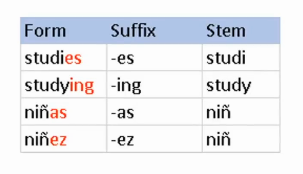

   Stemming is not a good process for normalization. since sometimes it can produce non-meaningful words which are not present in the dictionary. Consider the sentence ” His teams are not winning”. After stemming we get “Hi team are not winn ” . Notice that the keyword winn is not a regular word. Also, “hi” has changed the context of the entire sentence.

   * 2)Lemmatization-
   It is a systematic process of removing the inflectional form of a token and transform it into a lemma. It makes use of word structure, vocabulary, part of speech tags, and grammar relations.

   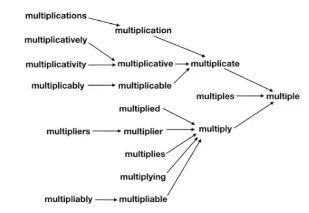


   The output of lemmatization is a root word called a lemma. for example “am”, “are”, “is” will be converted to “be”. Similarly, running runs, ‘ran’ will be replaced by ‘run’.


Now let’s stitch these tokens back together. It can easily be done using nltk’s MosesDetokenizer function.
for i in range(len(tokenized_tweet)):
    tokenized_tweet[i] = ' '.join(tokenized_tweet[i])
combi['tidy_tweet'] = tokenized_twe

In [19]:
# Tokenizing

tokenized_tweet = df['clean_tweet'].apply(lambda x: x.split())
tokenized_tweet.head(10)

0    [when, father, dysfunctional, selfish, drags, ...
1    [thanks, #lyft, credit, cause, they, offer, wh...
2                              [bihday, your, majesty]
3                     [#model, love, take, with, time]
4                   [factsguide, society, #motivation]
5    [huge, fare, talking, before, they, leave, cha...
6                           [camping, tomorrow, danny]
7    [next, school, year, year, exams, think, about...
8    [love, land, #allin, #cavs, #champions, #cleve...
9                                      [welcome, here]
Name: clean_tweet, dtype: object

In [20]:
# Normalizing the tokenized tweets

from nltk.stem.porter import *
stemmer = PorterStemmer()
tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(i) for i in x]) # stemming

In [21]:
# stitching these tokens back together by using nltk’s MosesDetokenizer function.
for i in range(len(tokenized_tweet)):
    tokenized_tweet[i] = ' '.join(tokenized_tweet[i])
df['clean_tweet'] = tokenized_tweet

# **3] Data Visualization from Tweets :**

**A)Common words used in the tweets: WordCloud-**

In [22]:
import plotly.graph_objects as go
from wordcloud import WordCloud

all_words = ' '.join([text for text in df['clean_tweet']])
wordcloud = WordCloud(width=800, height=500, random_state=21, max_font_size=110).generate(all_words)

fig = go.Figure(data=[go.Image(z=wordcloud.to_array())])
fig.update_layout(title='Word Cloud', width=800, height=500, margin=dict(l=0, r=0, t=50, b=0))

fig.show()


👉 As We can see most of the words are positive or neutral. Words like love, great, friend, life are the most frequent ones. It doesn’t give us any idea about the words associated with the racist/sexist tweets. Hence, we will plot separate wordclouds for both the classes (racist/sexist or not) in our train data.

**B) Words in non racist/sexist tweets-**

👉 Most of the frequent words are compatible with the sentiment, i.e, non-racist/sexists tweets.

In [23]:
from PIL import Image
import numpy as np
from wordcloud import WordCloud
import plotly.graph_objects as go

twitter_mask = np.array(Image.open('/content/drive/MyDrive/twitter_mask.png'))

wc = WordCloud(
    background_color='white',
    max_words=200,
    mask=twitter_mask,
)
wc.generate(' '.join([text for text in df['clean_tweet'][df['label'] == 0]]))

wordcloud_array = np.array(wc)

fig = go.Figure(data=go.Image(z=wordcloud_array))

fig.update_layout(
    title='Top words for non racist/sexist tweets- Label=0',
    title_font_size=22,
    images=[go.layout.Image(x=0, y=0, sizex=1, sizey=1, source='image.png', layer='below')]
)

fig.show()


👉Most of the frequent words are compatible with the sentiment, i.e, non-racist/sexists tweets.

**C) Racist/Sexist Tweets-**

In [24]:

twitter_mask = np.array(Image.open('/content/drive/MyDrive/twitter_mask.png'))

wc = WordCloud(
    background_color='white',
    max_words=200,
    mask=twitter_mask,
)
wc.generate(' '.join([text for text in df['clean_tweet'][df['label'] == 1]]))

wordcloud_array = np.array(wc)

fig = go.Figure(data=go.Image(z=wordcloud_array))

fig.update_layout(
    title='Top words for racist/sexist tweets- Label=1',
    title_font_size=22,
    images=[go.layout.Image(x=0, y=0, sizex=1, sizey=1, source='image.png', layer='below')]
)

fig.show()

👉As we can clearly see, most of the words have negative connotations.

**D) Understanding the impact of Hashtags on tweets sentiment-**

In [25]:
# function to collect hashtags
def hashtag_extract(x):
    hashtags = []
    # Loop over the words in the tweet
    for i in x:
        ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)

    return hashtags

In [26]:
# extracting hashtags from non racist/sexist tweets

HT_regular = hashtag_extract(df['clean_tweet'][df['label'] == 0])

# extracting hashtags from racist/sexist tweets
HT_negative = hashtag_extract(df['clean_tweet'][df['label'] == 1])

# unnesting list
HT_regular = sum(HT_regular,[])
HT_negative = sum(HT_negative,[])

Now that we have prepared our lists of hashtags for both the sentiments, we can plot the top 'n' hashtags.

**Checking the hashtags in the non-racist/sexist tweets.** 👇

**# Non-Racist/Sexist Tweets-**

In [27]:
a = nltk.FreqDist(HT_regular)
d = pd.DataFrame({'Hashtag': list(a.keys()),
                  'Count': list(a.values())})

d = d.nlargest(columns="Count", n=20)

colors = px.colors.qualitative.Pastel

fig = px.bar(d, x="Hashtag", y="Count", labels={'Count': 'Count'}, height=500,
             color="Hashtag", color_discrete_sequence=colors)

fig.update_layout(
    title="Top 20 Most Frequent Hashtags",
    xaxis_title="Hashtag",
    yaxis_title="Count",
    plot_bgcolor='white',
    paper_bgcolor='white'
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()


👉All these hashtags are positive and it makes sense.

**#Racist/Sexist Tweets**

In [28]:
a = nltk.FreqDist(HT_negative)
d = pd.DataFrame({'Hashtag': list(a.keys()),
                  'Count': list(a.values())})

d = d.nlargest(columns="Count", n=20)

colors = px.colors.qualitative.Pastel

fig = px.bar(d, x="Hashtag", y="Count", labels={'Count': 'Count'}, height=500,
             color="Hashtag", color_discrete_sequence=colors)

fig.update_layout(
    title="Top 20 Most Frequent Hashtags",
    xaxis_title="Hashtag",
    yaxis_title="Count",
    plot_bgcolor='white',
    paper_bgcolor='white'
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()


👉 As expected, most of the terms are negative with a few neutral terms as well. So, it’s not a bad idea to keep these hashtags in our data as they contain useful information. Next, we will try to extract features from the tokenized tweets.

# **4] Extracting Features from Cleaned Tweets :**

* Bag-of-Words
* TF-IDF
* Word Embeddings

In [29]:
# import sklearn
# from sklearn.feature_extraction.text import CountVectorizer
# vectorizer = CountVectorizer()


# # Importing CountVectorizer in order to implement the Bag of words model.

# vectorizer = CountVectorizer(max_df=0.90, min_df=2, stop_words='english')
# count_matrix = vectorizer.fit_transform(df["celean_tweet"])
# count_array = count_matrix.toarray()
# df = pd.DataFrame(data=count_array,columns = vectorizer.vocabulary_.keys())
# print(df)

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import gensim

In [31]:
bow_vectorizer = CountVectorizer(max_df=0.90, min_df=2, max_features=1000, stop_words='english')
bow = bow_vectorizer.fit_transform(df['clean_tweet'])
bow.shape

(49159, 1000)

In [32]:
tfidf_vectorizer = TfidfVectorizer(max_df=0.90, min_df=2, max_features=1000, stop_words='english')
tfidf = tfidf_vectorizer.fit_transform(df['clean_tweet'])
tfidf.shape

(49159, 1000)

In [33]:
train_bow = bow[:31962,:]
test_bow = bow[31962:,:]

In [34]:
train_bow.shape

(31962, 1000)

In [35]:
test_bow.shape

(17197, 1000)

In [36]:
df["label"].shape

(49159,)

In [37]:
# from imblearn.over_sampling import SMOTE
# smote=SMOTE()
# X_resample,y_resampled=smote.fit_resample(train_bow, data_train["label"])

In [39]:
possitive_tweet = df[df["label"] == 1.0]
negative_tweet  = df[df["label"] == 0.0]

In [40]:
from sklearn.utils import resample
tweet_upsample = resample(possitive_tweet,n_samples=len(negative_tweet),random_state=42)

print(tweet_upsample.shape)

(29720, 4)


In [41]:
print(tweet_upsample.shape)
data_upsampled = pd.concat([negative_tweet, tweet_upsample])

(29720, 4)


In [ ]:
#1. Logistic Regression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

In [ ]:
# splitting data into training and validation set
xtrain_bow, xvalid_bow, ytrain, yvalid = train_test_split(X_resample, y_resampled, random_state=42, test_size=0.25)

lreg = LogisticRegression()
lreg.fit(xtrain_bow, ytrain) # training the model

prediction = lreg.predict_proba(xtrain_bow)
prediction_int_train = prediction[:,1] >= 0.3
prediction_int_train = prediction_int_train.astype(np.int)

print(f1_score(ytrain, prediction_int_train))

prediction = lreg.predict_proba(xvalid_bow)
prediction_int = prediction[:,1] >= 0.3
prediction_int = prediction_int.astype(np.int)

f1_score(yvalid, prediction_int)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=1000,max_depth=100,random_state=0).fit(X_resample, y_resampled)
train_pred = rf.predict(xtrain_bow)
prediction = rf.predict(xvalid_bow)
print(f1_score(ytrain, train_pred))
print(f1_score(yvalid, prediction))

In [ ]:
from xgboost import XGBClassifier
xgb_model = XGBClassifier(max_depth=3, n_estimators=1000).fit(X_resample, y_resampled)
prediction1 = xgb_model.predict(xvalid_bow)
train_pred1 = xgb_model.predict(xtrain_bow)
print(f1_score(ytrain, train_pred1))
print(f1_score(yvalid, prediction1))

In [ ]:
from sklearn import svm
svc=svm.SVC(kernel="linear",C=1,probability=True).fit(xtrain_bow, ytrain)
y_pred_train_svm=svc.predict_proba(xtrain_bow)
y_pred_train_svm_int=y_pred_train_svm[:,1]>=0.3
y_pred_train_svm_int=y_pred_train_svm_int.astype(np.int)
print(f1_score(ytrain,y_pred_train_svm_int))

y_pred_test_svm=svc.predict_proba(xtrain_bow)
y_pred_test_svm_int=y_pred_test_svm[:,1]>=0.3
y_pred_test_svm_int=y_pred_test_svm_int.astype(np.int)
f1_score(ytrain,y_pred_test_svm_int)

In [ ]:
! pip install bert-serving-server
! pip install bert-serving-client

In [ ]:
# from bert_serving.client import BertClient

# # make a connection with the BERT server using it's ip address
# bc = BertClient()
# # get the embedding for train and val sets
# X_train_bert = bc.encode(xtrain_bow.tolist())
# X_test_bert = bc.encode(xvalid_bow.tolist())
# from sklearn.linear_model import LogisticRegression

# #xtrain_bow, xvalid_bow, ytrain, yvalid = train_test_split(X_resample, y_resampled, random_state=42, test_size=0.25)

# # LR model
# model_bert = LogisticRegression()
# # train
# model_bert = model_bert.fit(X_train_bert, ytrain)
# # predict
# pred_bert_train = model_bert.predict(X_train_bert)
# pred_bert_test = model_bert.predict(X_test_bert)

# print(f1_score(ytrain, pred_bert_train))
# print(f1_score(yvalid, pred_bert_test))